1. Generating Synthetic Faces using Deep Convolutional GAN (DCGAN)

Epoch 1, Gen Loss: 4.1476, Disc Loss: 0.0560, Time: 39.99s


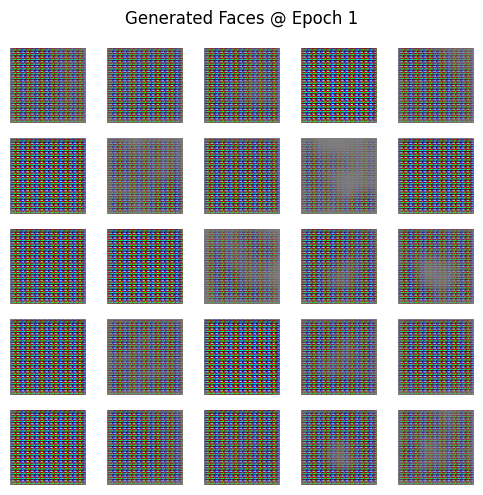

Epoch 2, Gen Loss: 6.3880, Disc Loss: 0.0091, Time: 37.60s


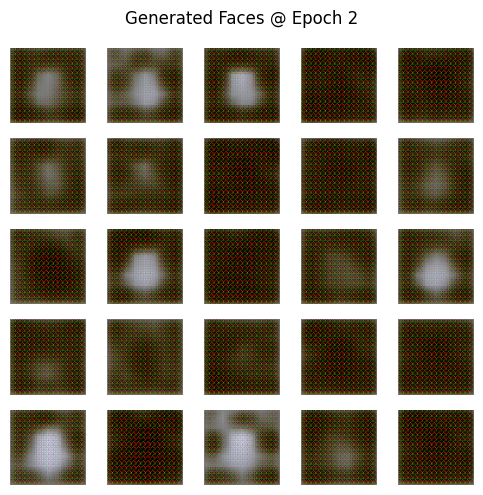

Epoch 3, Gen Loss: 7.8716, Disc Loss: 0.0121, Time: 37.60s


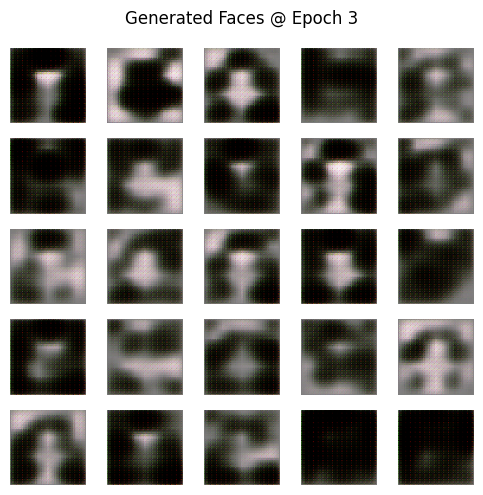

Epoch 4, Gen Loss: 6.3499, Disc Loss: 0.0288, Time: 40.95s


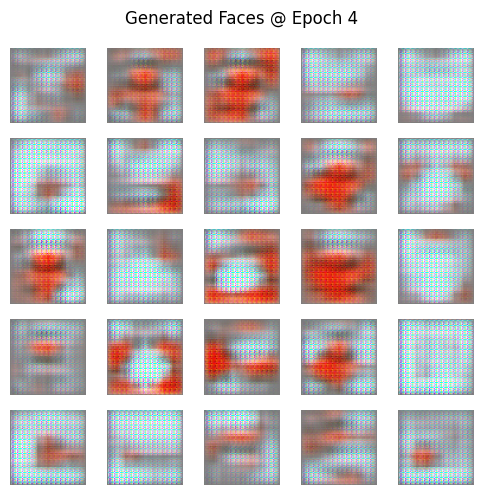

Epoch 5, Gen Loss: 5.6981, Disc Loss: 0.0569, Time: 37.93s


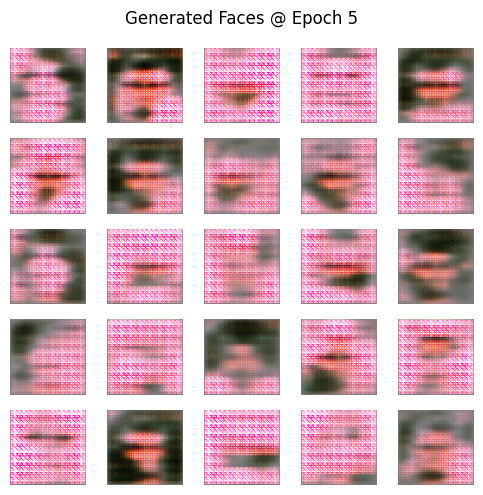

Epoch 6, Gen Loss: 2.1664, Disc Loss: 0.4314, Time: 38.53s


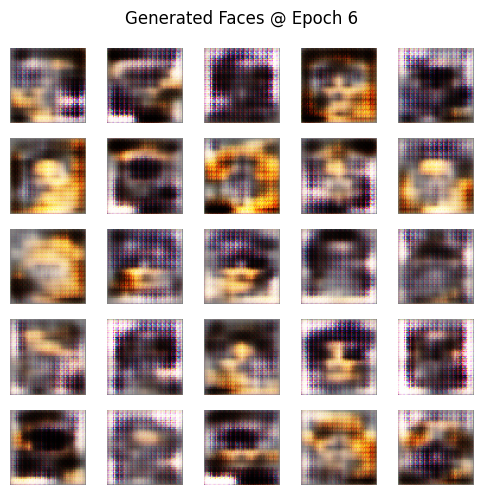

Epoch 7, Gen Loss: 4.0534, Disc Loss: 0.2428, Time: 37.49s


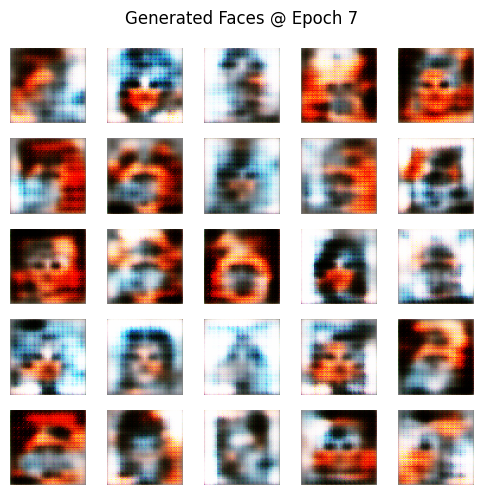

Epoch 8, Gen Loss: 3.1171, Disc Loss: 0.2250, Time: 40.94s


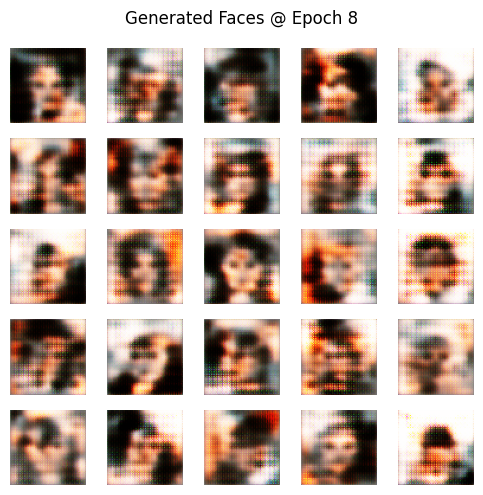

Epoch 9, Gen Loss: 2.7217, Disc Loss: 0.9935, Time: 38.39s


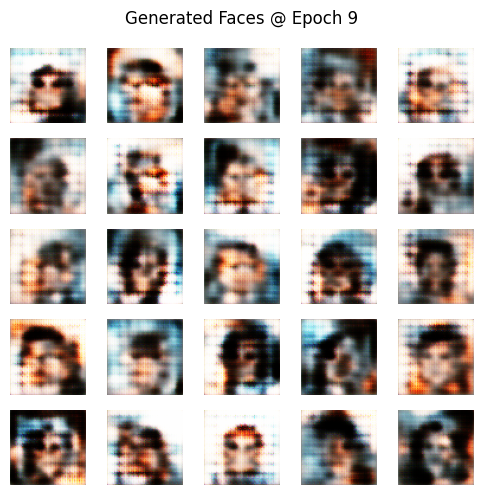

Epoch 10, Gen Loss: 2.0947, Disc Loss: 0.9260, Time: 37.34s


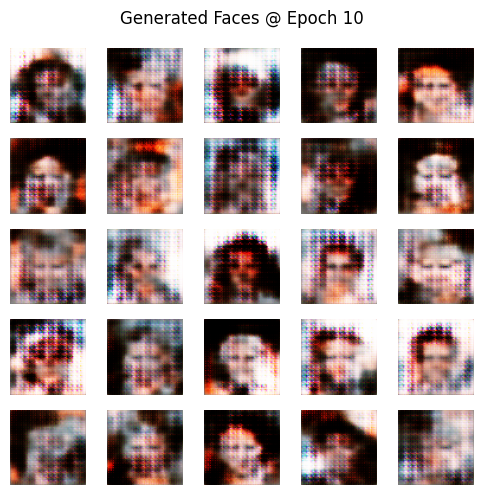

Epoch 11, Gen Loss: 2.2031, Disc Loss: 0.2942, Time: 37.11s


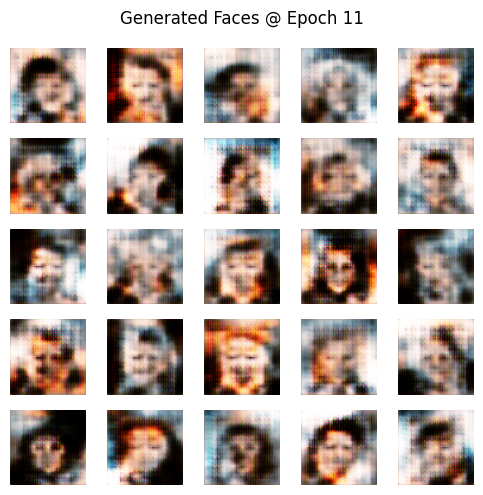

Epoch 12, Gen Loss: 1.8377, Disc Loss: 0.7693, Time: 37.28s


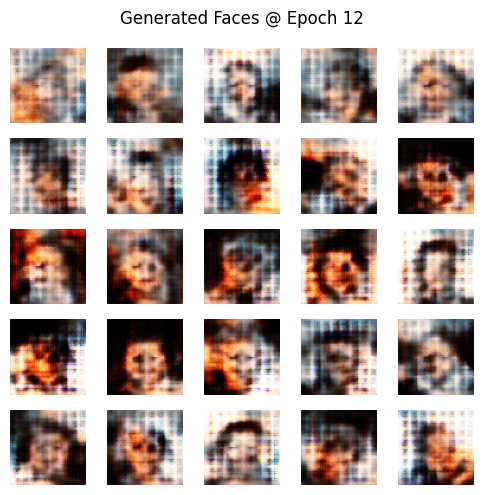

Epoch 13, Gen Loss: 2.6078, Disc Loss: 0.5520, Time: 37.74s


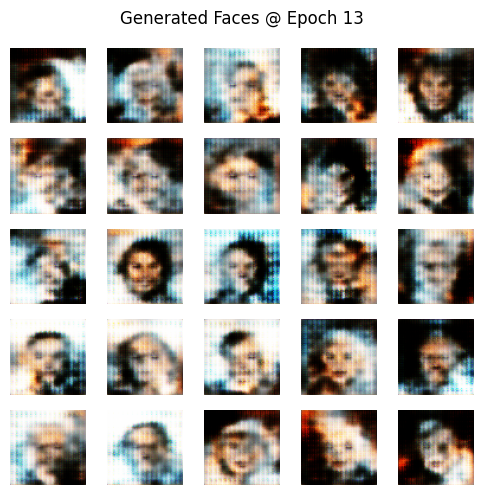

Epoch 14, Gen Loss: 1.8558, Disc Loss: 0.3832, Time: 37.86s


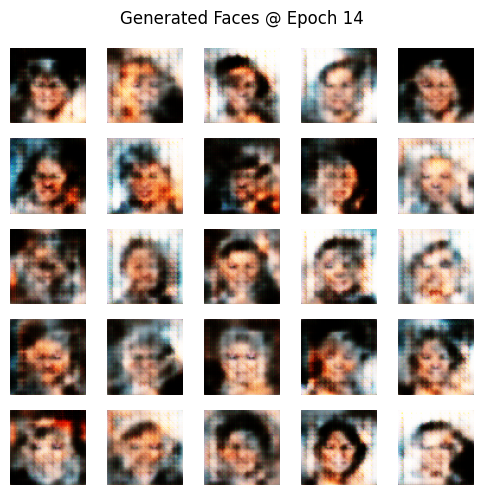

Epoch 15, Gen Loss: 1.2141, Disc Loss: 0.9062, Time: 37.56s


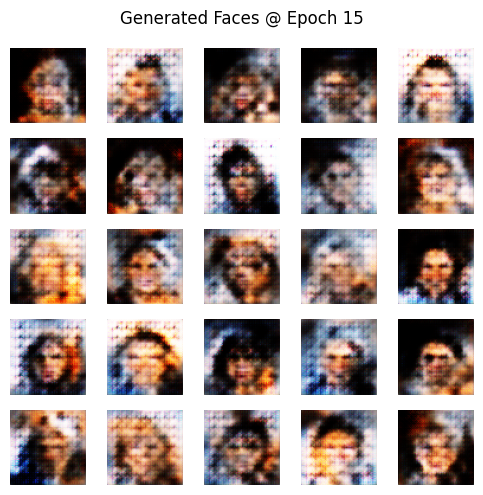

Epoch 16, Gen Loss: 3.7472, Disc Loss: 0.5043, Time: 40.94s


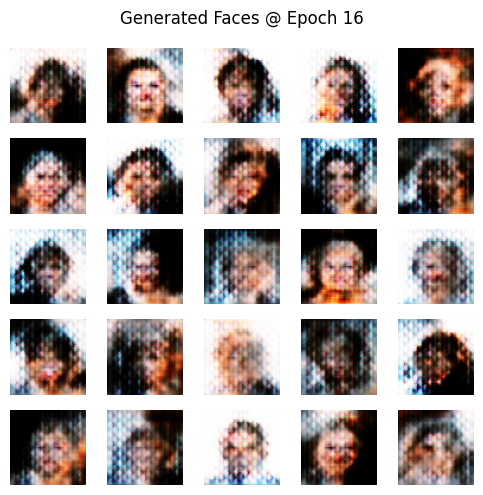

Epoch 17, Gen Loss: 1.7708, Disc Loss: 0.6886, Time: 38.21s


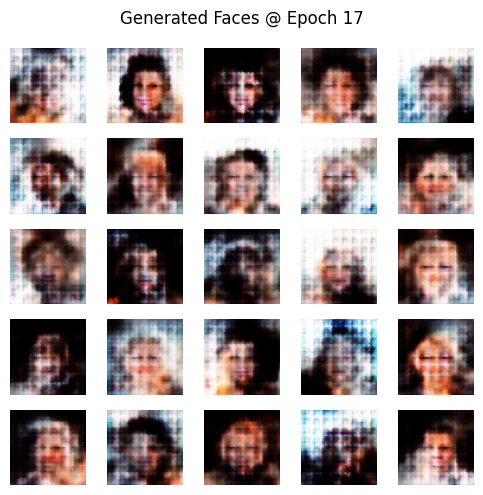

Epoch 18, Gen Loss: 2.6002, Disc Loss: 0.1845, Time: 38.89s


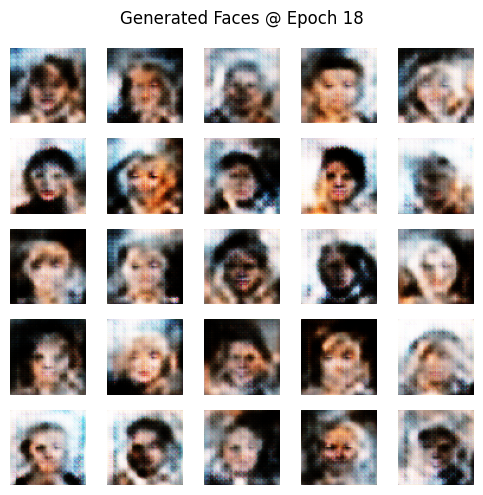

Epoch 19, Gen Loss: 2.2414, Disc Loss: 0.8117, Time: 39.99s


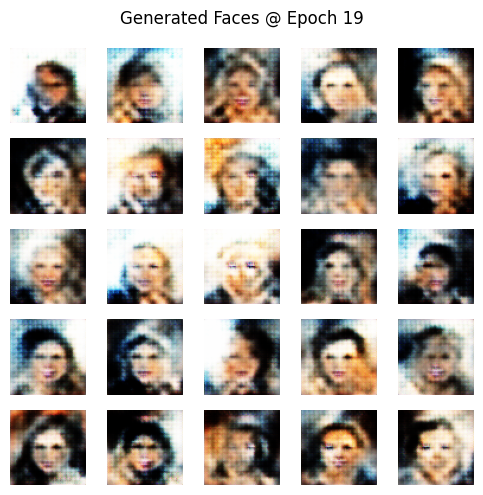

Epoch 20, Gen Loss: 1.8396, Disc Loss: 0.5920, Time: 41.86s


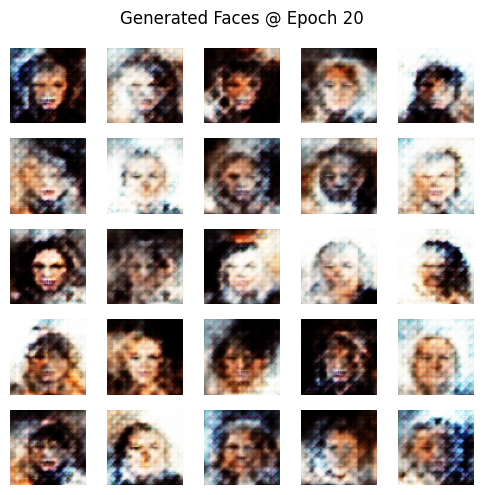

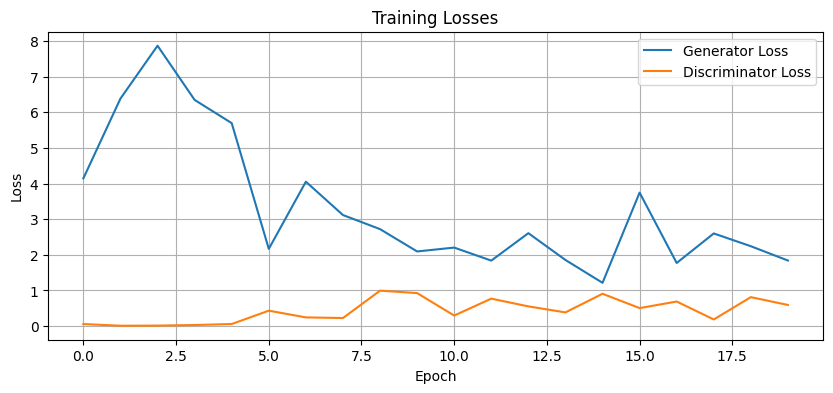

In [4]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
from PIL import Image
import time

# ============ 1. Load CelebA Dataset from local ============

def load_celeba_from_zip(zip_path, image_size=(64, 64), limit=5000):
    import zipfile
    with zipfile.ZipFile(zip_path, 'r') as archive:
        image_files = [f for f in archive.namelist() if f.endswith('.jpg')]
        image_files.sort()
        all_images = []
        for file in image_files[:limit]:
            with archive.open(file) as f:
                img = Image.open(f).convert('RGB')
                img = img.resize(image_size)
                img = np.array(img)
                all_images.append(img)
    images_np = np.stack(all_images, axis=0)
    images_np = (images_np.astype('float32') - 127.5) / 127.5
    return tf.data.Dataset.from_tensor_slices(images_np).shuffle(1000).batch(16)

dataset = load_celeba_from_zip("Datasets/img_align_celeba.zip")

# ============ 2. Generator ============

def make_generator():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8 * 8 * 256, use_bias=False, input_shape=(100,)))
    model.add(layers.LeakyReLU())
    model.add(layers.Reshape((8, 8, 256)))
    model.add(layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', use_bias=False, activation='tanh'))
    return model

# ============ 3. Discriminator ============

def make_discriminator():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (4,4), strides=(2,2), padding='same', input_shape=[64,64,3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(128, (4,4), strides=(2,2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(256, (4,4), strides=(2,2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Flatten())
    model.add(layers.Dense(1))
    return model

# ============ 4. Loss + Optimizers ============

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
generator = make_generator()
discriminator = make_discriminator()
gen_optimizer = tf.keras.optimizers.Adam(1e-4)
disc_optimizer = tf.keras.optimizers.Adam(1e-4)

# ============ 5. Training Loop ============

@tf.function
def train_step(images):
    noise = tf.random.normal([16, 100])
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated, training=True)

        gen_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
        disc_loss = cross_entropy(tf.ones_like(real_output), real_output) + \
                    cross_entropy(tf.zeros_like(fake_output), fake_output)

    grads_gen = gen_tape.gradient(gen_loss, generator.trainable_variables)
    grads_disc = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(grads_gen, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(grads_disc, discriminator.trainable_variables))
    return gen_loss, disc_loss

# ============ 6. Train ============

def train(dataset, epochs):
    gen_losses, disc_losses = [], []
    for epoch in range(epochs):
        start = time.time()
        for batch in dataset:
            g_loss, d_loss = train_step(batch)
        print(f"Epoch {epoch+1}, Gen Loss: {g_loss:.4f}, Disc Loss: {d_loss:.4f}, Time: {time.time()-start:.2f}s")
        gen_losses.append(g_loss)
        disc_losses.append(d_loss)
        generate_and_save_images(generator, epoch + 1)
    return gen_losses, disc_losses

# ============ 7. Visualize Results ============

def generate_and_save_images(model, epoch, n=5):
    seed = tf.random.normal([n * n, 100])
    preds = model(seed, training=False)
    preds = (preds + 1.0) / 2.0
    fig = plt.figure(figsize=(n, n))
    for i in range(preds.shape[0]):
        plt.subplot(n, n, i + 1)
        plt.imshow(preds[i])
        plt.axis('off')
    plt.suptitle(f"Generated Faces @ Epoch {epoch}")
    plt.tight_layout()
    plt.show()

# ============ 8. Start Training ============

gen_losses, disc_losses = train(dataset, epochs=20)

# ============ 9. Plot Loss Curves ============

plt.figure(figsize=(10,4))
plt.plot(gen_losses, label='Generator Loss')
plt.plot(disc_losses, label='Discriminator Loss')
plt.legend()
plt.title('Training Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)
plt.show()


2. Generating Synthetic Faces with Long Hair using Conditional GAN (CGAN)

Epoch 1, Gen Loss: 3.6985, Disc Loss: 0.0324, Time: 26.21s


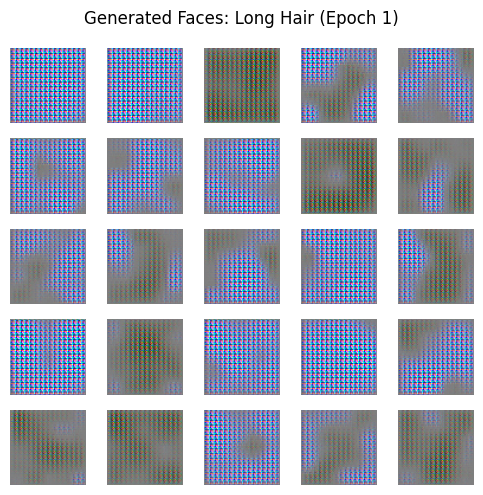

Epoch 2, Gen Loss: 5.0986, Disc Loss: 0.0456, Time: 24.74s


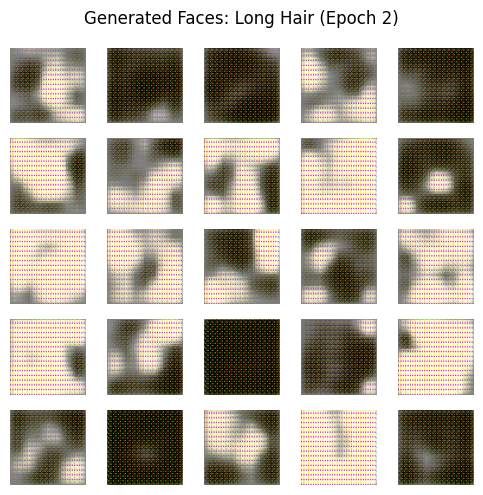

Epoch 3, Gen Loss: 4.6872, Disc Loss: 0.0309, Time: 24.81s


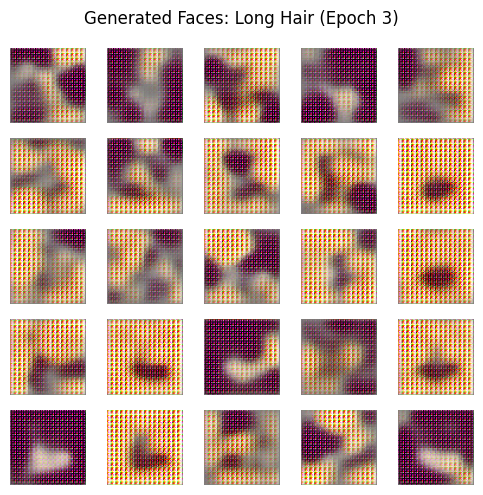

Epoch 4, Gen Loss: 4.7244, Disc Loss: 0.3942, Time: 24.23s


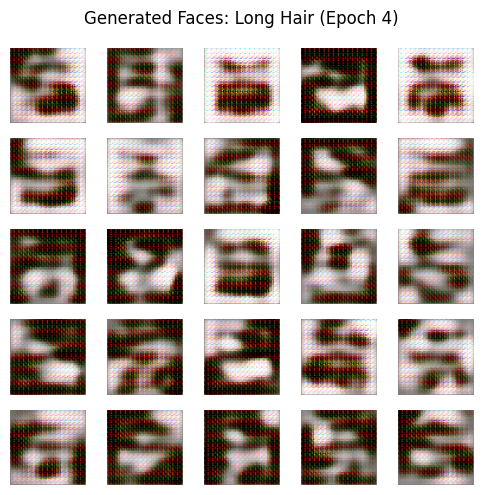

Epoch 5, Gen Loss: 3.4395, Disc Loss: 0.4373, Time: 24.33s


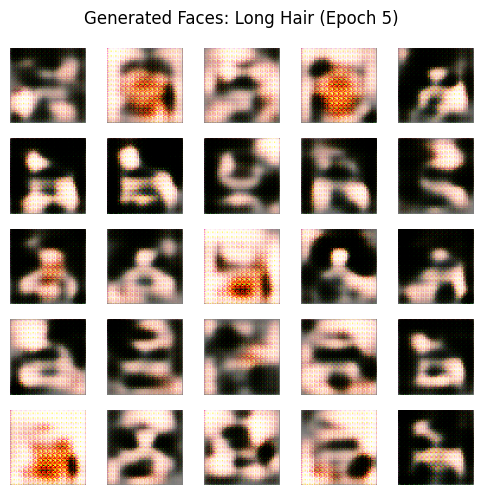

Epoch 6, Gen Loss: 2.7274, Disc Loss: 0.2660, Time: 24.78s


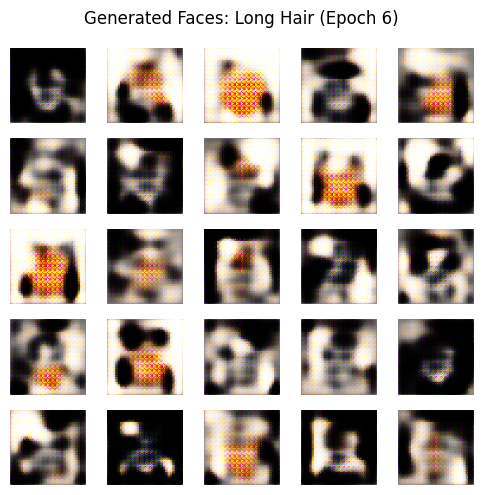

Epoch 7, Gen Loss: 2.3059, Disc Loss: 0.3371, Time: 24.82s


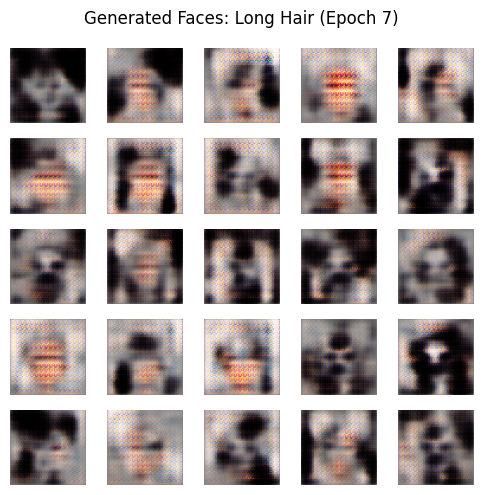

Epoch 8, Gen Loss: 2.3046, Disc Loss: 0.3189, Time: 24.01s


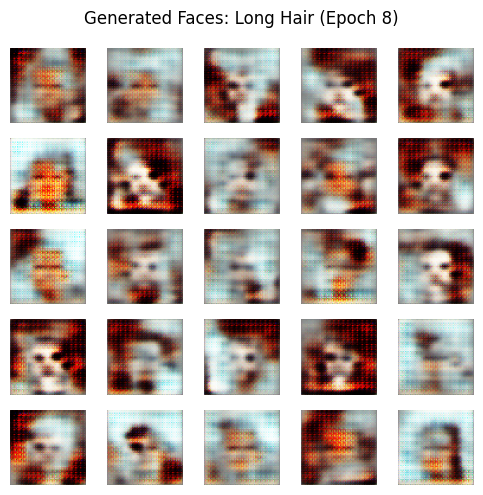

Epoch 9, Gen Loss: 3.6756, Disc Loss: 0.2503, Time: 24.10s


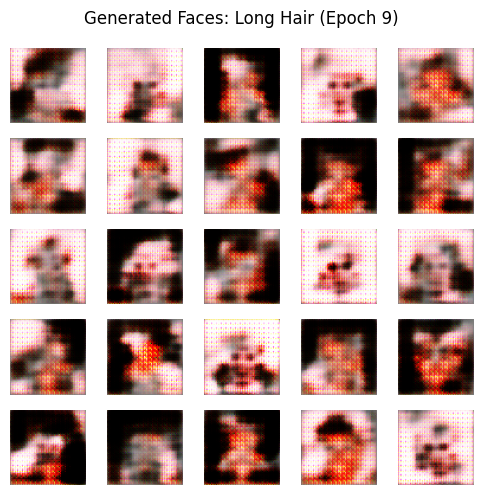

Epoch 10, Gen Loss: 2.5963, Disc Loss: 0.2765, Time: 24.22s


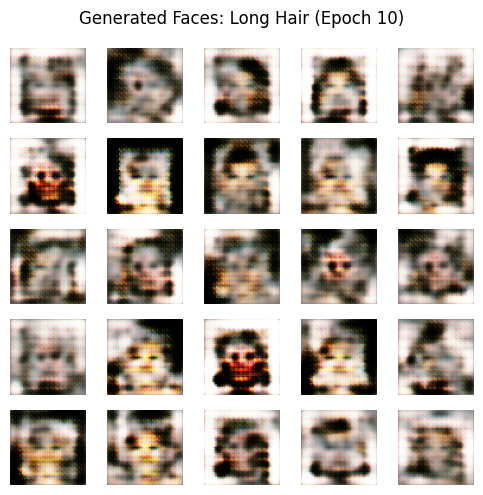

Epoch 11, Gen Loss: 1.8825, Disc Loss: 0.9252, Time: 24.20s


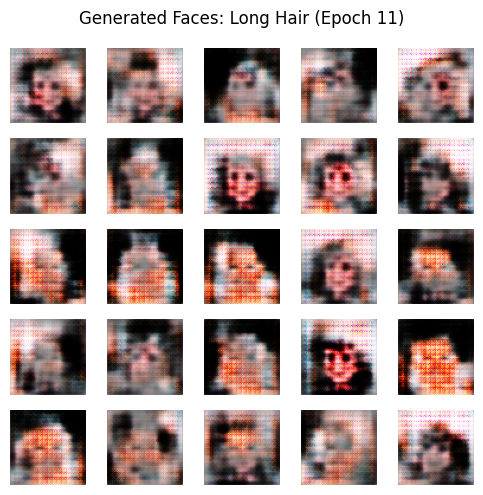

Epoch 12, Gen Loss: 1.3363, Disc Loss: 0.6753, Time: 24.15s


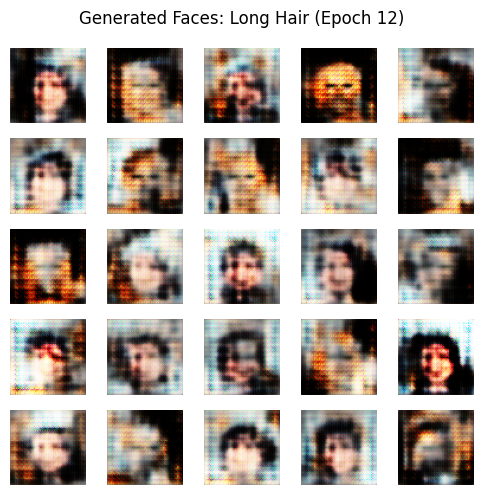

Epoch 13, Gen Loss: 1.5035, Disc Loss: 1.5050, Time: 24.24s


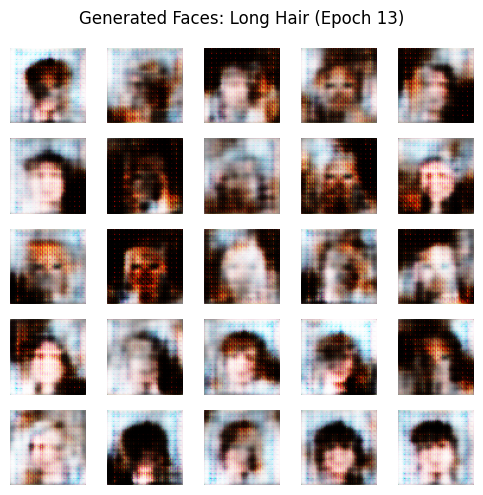

Epoch 14, Gen Loss: 1.9717, Disc Loss: 0.8285, Time: 24.15s


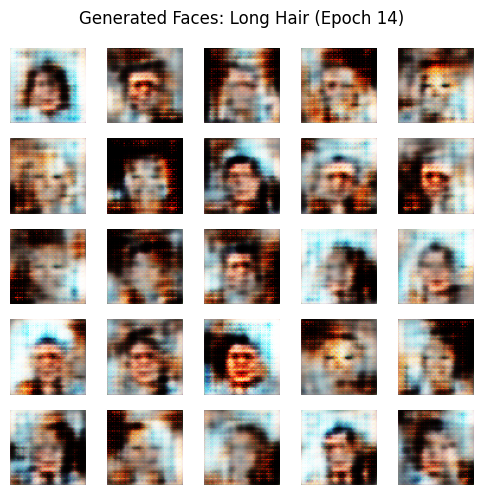

Epoch 15, Gen Loss: 1.5400, Disc Loss: 0.9973, Time: 40.95s


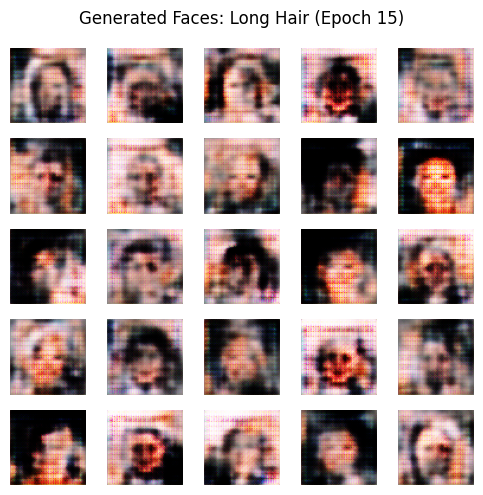

Epoch 16, Gen Loss: 1.3139, Disc Loss: 0.9321, Time: 24.22s


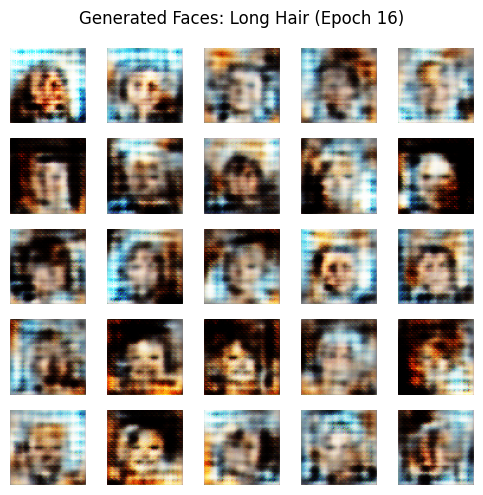

Epoch 17, Gen Loss: 0.9558, Disc Loss: 0.6989, Time: 40.95s


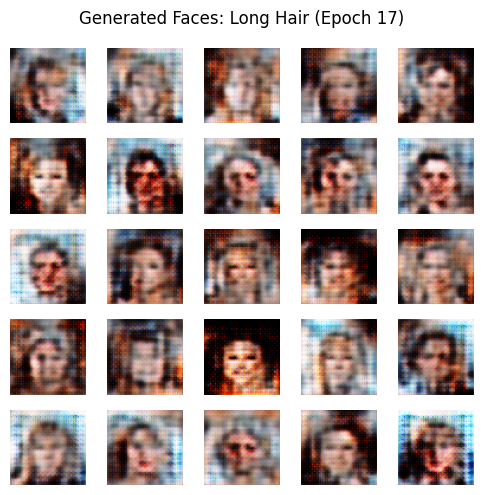

Epoch 18, Gen Loss: 0.7363, Disc Loss: 1.1185, Time: 24.26s


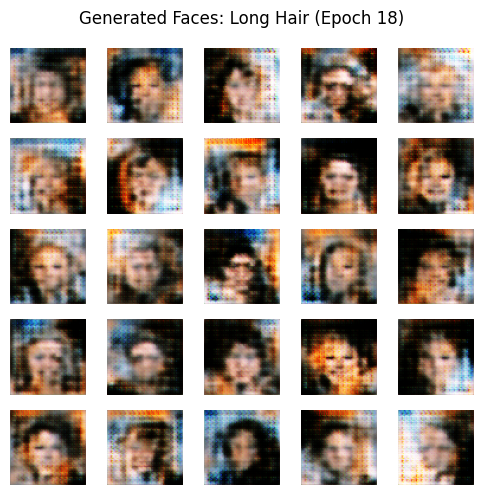

Epoch 19, Gen Loss: 0.9913, Disc Loss: 0.8063, Time: 24.15s


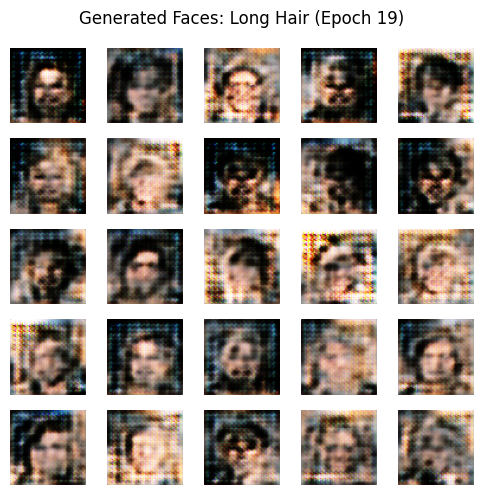

Epoch 20, Gen Loss: 1.1899, Disc Loss: 0.8676, Time: 24.25s


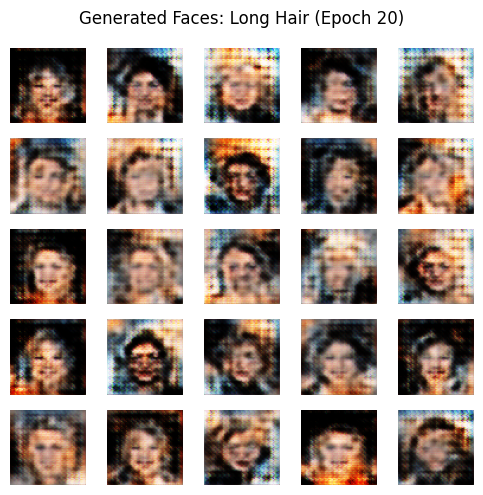

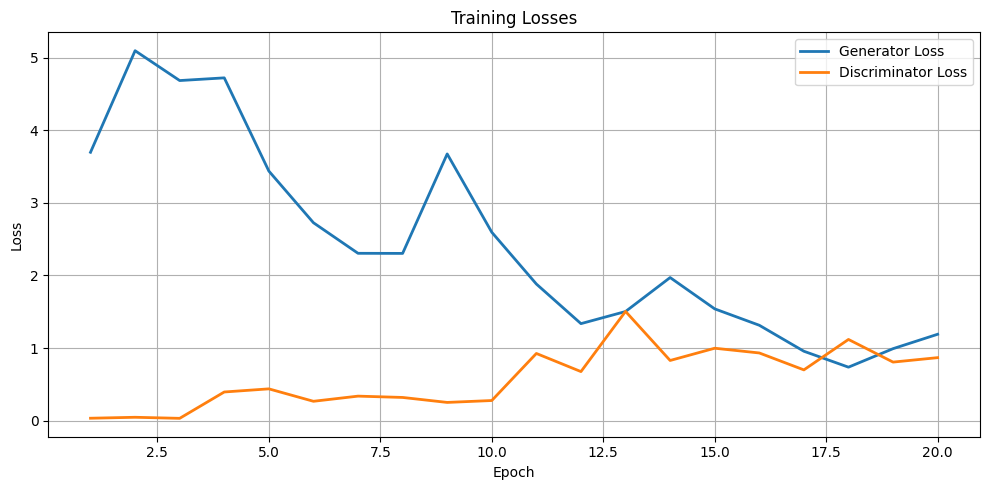

In [13]:
import tensorflow as tf
from tensorflow.keras import layers
import pandas as pd
import numpy as np
from PIL import Image
import zipfile
import os
import matplotlib.pyplot as plt
import time

# =============================
# 1. Load CelebA with Long Hair Labels
# =============================
def load_celeba_with_long_hair(zip_path, attr_path, image_size=(64, 64), limit=5000):
    df = pd.read_csv(attr_path, sep='\s+', skiprows=1)
    df = df.reset_index().rename(columns={'index': 'filename'})
    df['Long_Hair'] = df['Bald'].apply(lambda x: 0 if x == 1 else 1)
    df = df[['filename', 'Long_Hair']][:limit]

    with zipfile.ZipFile(zip_path, 'r') as zf:
        zip_files = set(zf.namelist())
        all_images, all_labels = [], []

        for _, row in df.iterrows():
            filename = row['filename']
            zip_img_path = f"img_align_celeba/{filename}"
            if zip_img_path in zip_files:
                with zf.open(zip_img_path) as f:
                    img = Image.open(f).convert('RGB').resize(image_size)
                    all_images.append(np.array(img, dtype=np.float32))
                    all_labels.append(row['Long_Hair'])

    if len(all_images) == 0:
        raise ValueError("No images found. Check paths.")

    images_np = np.stack(all_images, axis=0)
    labels_np = np.array(all_labels).astype(np.int32)
    images_np = (images_np - 127.5) / 127.5
    return tf.data.Dataset.from_tensor_slices((images_np, labels_np)).shuffle(1000).batch(32)

dataset = load_celeba_with_long_hair("Datasets/img_align_celeba.zip", "Datasets/list_attr_celeba.txt")

# =============================
# 2. Conditional Generator
# =============================
def make_conditional_generator():
    noise = layers.Input(shape=(100,))
    label = layers.Input(shape=(1,))
    
    label_embedding = layers.Embedding(2, 50)(label)
    label_embedding = layers.Dense(8 * 8)(label_embedding)
    label_embedding = layers.Reshape((8, 8, 1))(label_embedding)

    x = layers.Dense(8 * 8 * 256, use_bias=False)(noise)
    x = layers.Reshape((8, 8, 256))(x)

    x = layers.Concatenate()([x, label_embedding])
    x = layers.Conv2DTranspose(128, 4, 2, padding='same', use_bias=False)(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2DTranspose(64, 4, 2, padding='same', use_bias=False)(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2DTranspose(3, 4, 2, padding='same', use_bias=False, activation='tanh')(x)

    return tf.keras.Model([noise, label], x)

generator = make_conditional_generator()

# =============================
# 3. Conditional Discriminator
# =============================
def make_conditional_discriminator():
    image = layers.Input(shape=(64, 64, 3))
    label = layers.Input(shape=(1,))
    
    label_embedding = layers.Embedding(2, 50)(label)
    label_embedding = layers.Dense(64 * 64)(label_embedding)
    label_embedding = layers.Reshape((64, 64, 1))(label_embedding)

    x = layers.Concatenate()([image, label_embedding])
    x = layers.Conv2D(64, 4, 2, padding='same')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(128, 4, 2, padding='same')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Flatten()(x)
    out = layers.Dense(1)(x)

    return tf.keras.Model([image, label], out)

discriminator = make_conditional_discriminator()

# =============================
# 4. Loss and Optimizer
# =============================
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
gen_optimizer = tf.keras.optimizers.Adam(1e-4)
disc_optimizer = tf.keras.optimizers.Adam(1e-4)

# =============================
# 5. Train Step
# =============================
@tf.function
def train_step(images, labels):
    noise = tf.random.normal([images.shape[0], 100])
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        fake_images = generator([noise, labels], training=True)
        real_output = discriminator([images, labels], training=True)
        fake_output = discriminator([fake_images, labels], training=True)

        gen_loss = loss_fn(tf.ones_like(fake_output), fake_output)
        disc_loss = loss_fn(tf.ones_like(real_output), real_output) + \
                    loss_fn(tf.zeros_like(fake_output), fake_output)

    gen_grad = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_grad = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_grad, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_grad, discriminator.trainable_variables))
    return gen_loss, disc_loss

# =============================
# 6. Generate Images for Visualization
# =============================
def generate_and_show(epoch, label_value=1):
    noise = tf.random.normal([25, 100])
    labels = tf.constant([label_value] * 25)
    preds = generator([noise, labels], training=False)
    preds = (preds + 1) / 2.0

    plt.figure(figsize=(5, 5))
    for i in range(25):
        plt.subplot(5, 5, i+1)
        plt.imshow(preds[i])
        plt.axis('off')
    plt.suptitle(f"Generated Faces: {'Long Hair' if label_value == 1 else 'Not Long Hair'} (Epoch {epoch})")
    plt.tight_layout()
    plt.show()

# =============================
# 7. Train with Loss Curve Plotting
# =============================
def train(dataset, epochs):
    gen_losses = []
    disc_losses = []

    for epoch in range(epochs):
        start = time.time()
        for images, labels in dataset:
            g_loss, d_loss = train_step(images, labels)

        gen_losses.append(g_loss.numpy())
        disc_losses.append(d_loss.numpy())

        print(f"Epoch {epoch+1}, Gen Loss: {g_loss:.4f}, Disc Loss: {d_loss:.4f}, Time: {time.time()-start:.2f}s")
        generate_and_show(epoch+1, label_value=1)

    # Plot loss curves
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, epochs+1), gen_losses, label="Generator Loss", linewidth=2)
    plt.plot(range(1, epochs+1), disc_losses, label="Discriminator Loss", linewidth=2)
    plt.title("Training Losses")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# =============================
# 8. Start Training
# =============================
train(dataset, epochs=20)



3. Generating Painted Form of Faces using CycleGAN

2025-08-04 20:30:35.838282: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-08-04 20:30:35.838309: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-08-04 20:30:35.839429: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-08-04 20:30:35.845078: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-08-04 20:30:36.546486: W tensorflow/compiler/tf2

Epoch 1/10


2025-08-04 20:30:46.070055: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2025-08-04 20:30:50.406624: I external/local_xla/xla/service/service.cc:168] XLA service 0x73b20fe46a00 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-08-04 20:30:50.406645: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce GTX 1070, Compute Capability 6.1
2025-08-04 20:30:50.413245: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1754317850.512668   85509 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


GenG: 6.6132, GenF: 6.4673, DiscX: 0.5526, DiscY: 0.4142


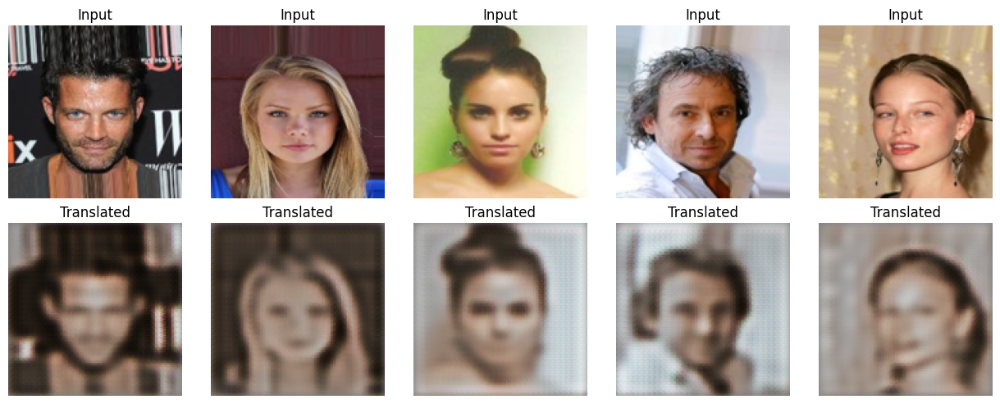

Epoch 2/10
GenG: 4.6809, GenF: 4.7419, DiscX: 0.3920, DiscY: 0.4189


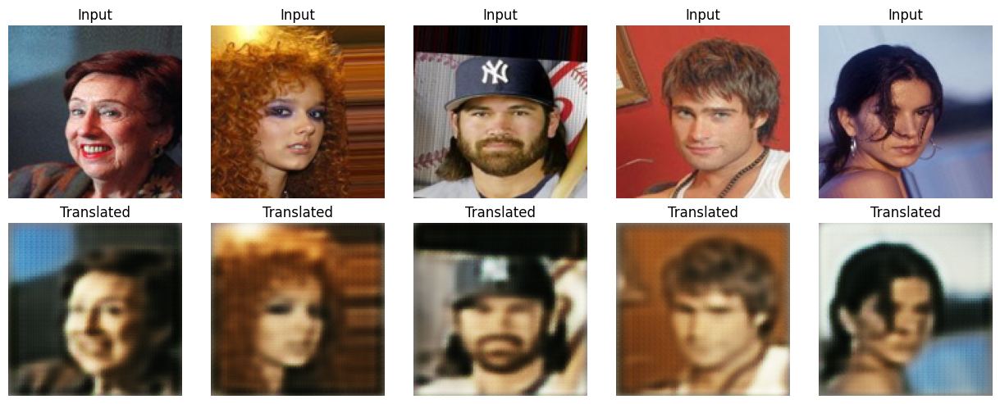

Epoch 3/10
GenG: 5.5527, GenF: 5.5733, DiscX: 0.3963, DiscY: 0.4877


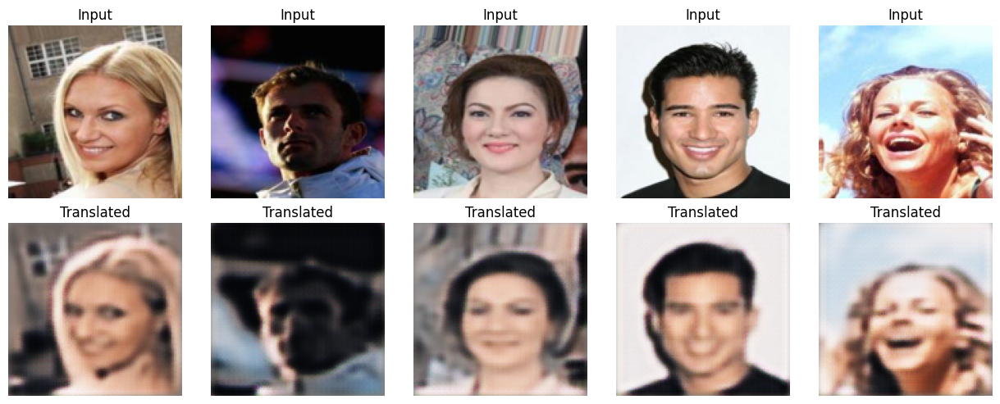

Epoch 4/10
GenG: 3.6842, GenF: 3.6213, DiscX: 0.3913, DiscY: 0.4110


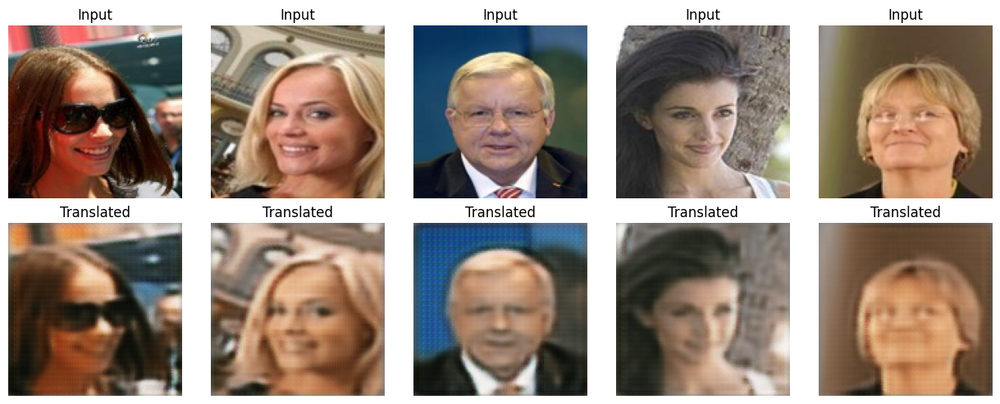

Epoch 5/10
GenG: 3.6231, GenF: 3.5312, DiscX: 0.4644, DiscY: 0.4620


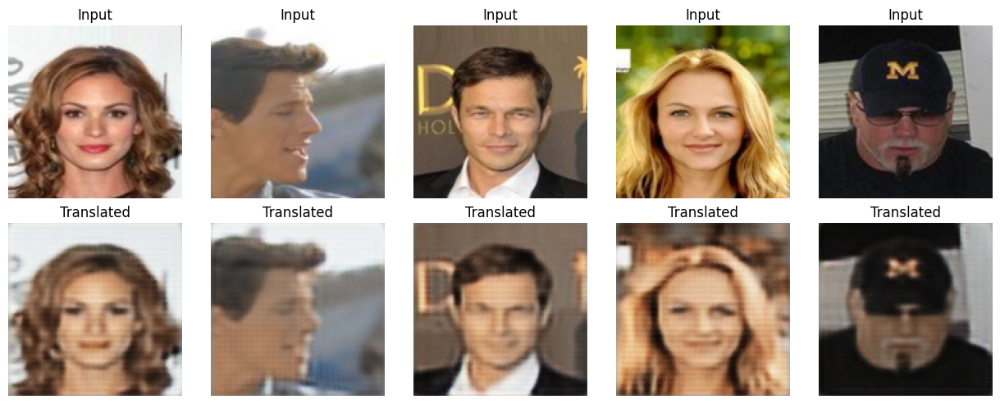

Epoch 6/10
GenG: 3.4442, GenF: 3.4078, DiscX: 0.4620, DiscY: 0.4594


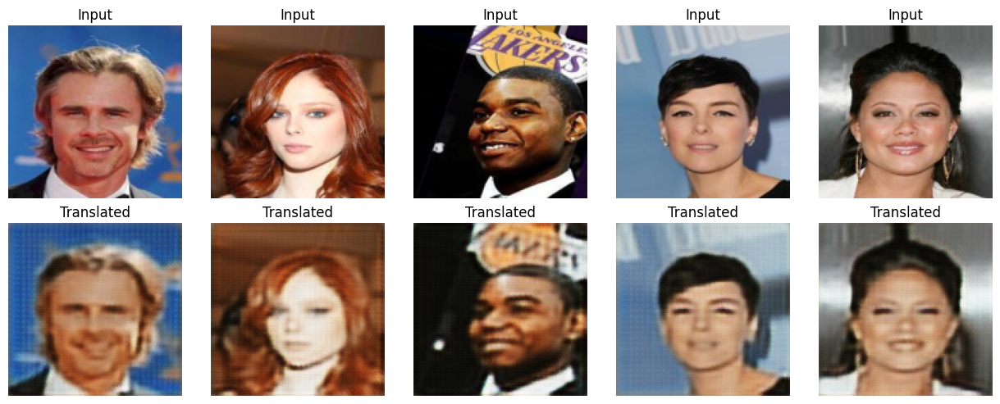

Epoch 7/10
GenG: 3.4020, GenF: 3.3624, DiscX: 0.5062, DiscY: 0.5274


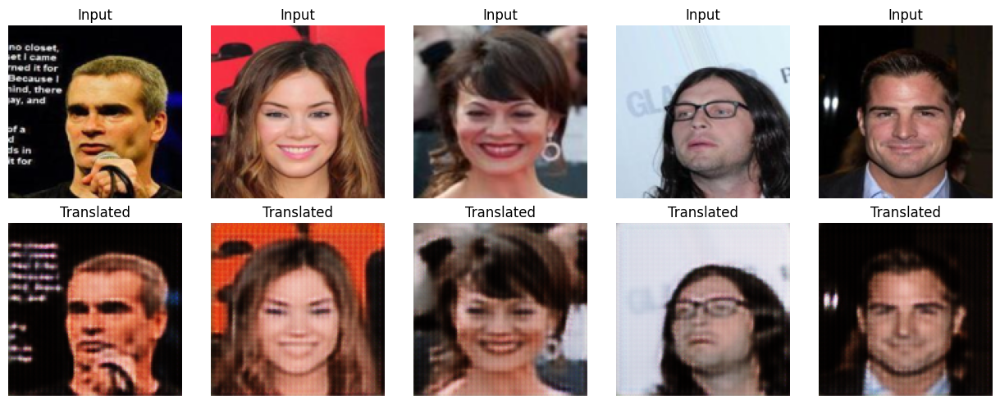

Epoch 8/10
GenG: 2.8356, GenF: 2.7472, DiscX: 0.4573, DiscY: 0.3458


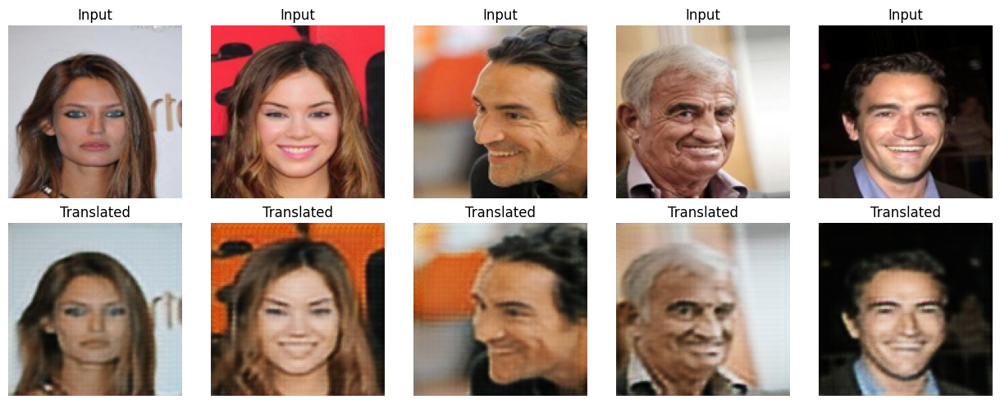

Epoch 9/10
GenG: 2.6853, GenF: 2.6715, DiscX: 0.4511, DiscY: 0.4551


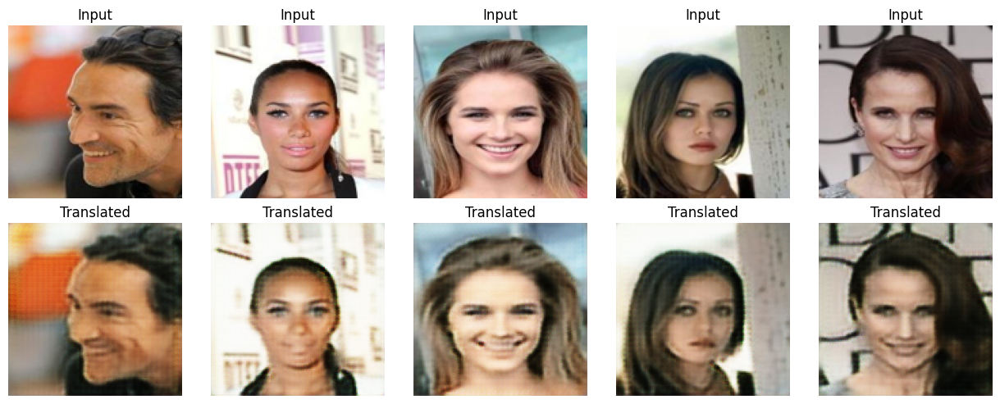

Epoch 10/10
GenG: 3.3146, GenF: 3.2644, DiscX: 0.4271, DiscY: 0.5705


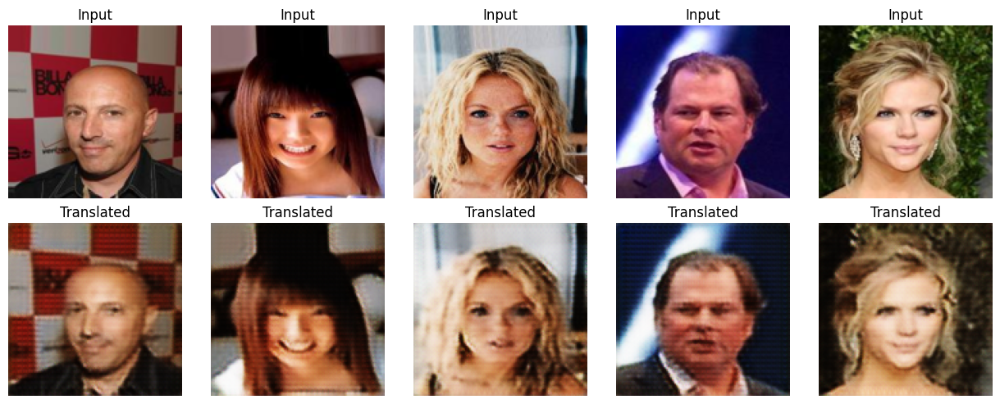

In [1]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import zipfile
import random
from PIL import Image
import matplotlib.pyplot as plt

# =============================
# 0. Config
# =============================
AUTOTUNE = tf.data.AUTOTUNE
IMG_SIZE = 128
BATCH_SIZE = 5  # Ensure 5 images for visualization
EPOCHS = 10

# =============================
# 1. Load CelebA and Split into Domain A and B
# =============================
def load_celeba_split(zip_path, image_size=(IMG_SIZE, IMG_SIZE), limit=1000):
    with zipfile.ZipFile(zip_path, 'r') as zf:
        image_files = sorted([f for f in zf.namelist() if f.endswith('.jpg')])[:limit]
        random.shuffle(image_files)
        half = len(image_files) // 2
        domain_a = image_files[:half]
        domain_b = image_files[half:]

        def extract_images(file_list):
            images = []
            for file in file_list:
                with zf.open(file) as f:
                    img = Image.open(f).convert('RGB').resize(image_size)
                    img = np.array(img).astype(np.float32)
                    images.append(img)
            images_np = np.stack(images)
            return (images_np / 127.5) - 1  # Normalize to [-1, 1]

        return extract_images(domain_a), extract_images(domain_b)

images_a, images_b = load_celeba_split("Datasets/img_align_celeba.zip")
train_a = tf.data.Dataset.from_tensor_slices(images_a).shuffle(1000).batch(BATCH_SIZE).prefetch(AUTOTUNE)
train_b = tf.data.Dataset.from_tensor_slices(images_b).shuffle(1000).batch(BATCH_SIZE).prefetch(AUTOTUNE)

# =============================
# 2. Generator Model
# =============================
def build_generator():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = layers.Conv2D(64, 7, padding='same')(inputs)
    x = layers.ReLU()(x)
    x = layers.Conv2D(128, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(256, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)

    for _ in range(3):
        res = x
        x = layers.Conv2D(256, 3, padding='same')(x)
        x = layers.ReLU()(x)
        x = layers.Conv2D(256, 3, padding='same')(x)
        x = layers.Add()([x, res])

    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)
    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)
    outputs = layers.Conv2D(3, 7, activation='tanh', padding='same')(x)
    return tf.keras.Model(inputs, outputs)

# =============================
# 3. Discriminator Model
# =============================
def build_discriminator():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = layers.Conv2D(64, 4, strides=2, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(256, 4, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(1, 4, padding='same')(x)
    return tf.keras.Model(inputs, x)

# =============================
# 4. Losses and Optimizers
# =============================
adv_loss = tf.keras.losses.MeanSquaredError()
cycle_loss_fn = tf.keras.losses.MeanAbsoluteError()

generator_g = build_generator()  # A → B
generator_f = build_generator()  # B → A
discriminator_x = build_discriminator()  # A
discriminator_y = build_discriminator()  # B

gen_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
gen_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
disc_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
disc_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# =============================
# 5. Training Step
# =============================
@tf.function
def train_step(real_x, real_y):
    with tf.GradientTape(persistent=True) as tape:
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        gen_g_loss = adv_loss(tf.ones_like(disc_fake_y), disc_fake_y)
        gen_f_loss = adv_loss(tf.ones_like(disc_fake_x), disc_fake_x)

        cycle_loss = cycle_loss_fn(real_x, cycled_x) + cycle_loss_fn(real_y, cycled_y)
        identity_loss = cycle_loss_fn(real_x, same_x) + cycle_loss_fn(real_y, same_y)

        total_gen_g = gen_g_loss + 10 * cycle_loss + 5 * identity_loss
        total_gen_f = gen_f_loss + 10 * cycle_loss + 5 * identity_loss

        disc_x_loss = adv_loss(tf.ones_like(disc_real_x), disc_real_x) + adv_loss(tf.zeros_like(disc_fake_x), disc_fake_x)
        disc_y_loss = adv_loss(tf.ones_like(disc_real_y), disc_real_y) + adv_loss(tf.zeros_like(disc_fake_y), disc_fake_y)

    gen_g_grads = tape.gradient(total_gen_g, generator_g.trainable_variables)
    gen_f_grads = tape.gradient(total_gen_f, generator_f.trainable_variables)
    disc_x_grads = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    disc_y_grads = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    gen_g_optimizer.apply_gradients(zip(gen_g_grads, generator_g.trainable_variables))
    gen_f_optimizer.apply_gradients(zip(gen_f_grads, generator_f.trainable_variables))
    disc_x_optimizer.apply_gradients(zip(disc_x_grads, discriminator_x.trainable_variables))
    disc_y_optimizer.apply_gradients(zip(disc_y_grads, discriminator_y.trainable_variables))

    return total_gen_g, total_gen_f, disc_x_loss, disc_y_loss

# =============================
# 6. Visualization: 5 Images Grid
# =============================
def generate_images(model, input_batch, num_images=5):
    predictions = model(input_batch, training=False)
    plt.figure(figsize=(num_images * 2.5, 5))

    for i in range(num_images):
        plt.subplot(2, num_images, i + 1)
        plt.imshow((input_batch[i] + 1) / 2)
        plt.title("Input")
        plt.axis('off')

        plt.subplot(2, num_images, num_images + i + 1)
        plt.imshow((predictions[i] + 1) / 2)
        plt.title("Translated")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# =============================
# 7. Training Loop
# =============================
def train(train_a, train_b, epochs):
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        for real_x, real_y in tf.data.Dataset.zip((train_a, train_b)):
            g1, g2, d1, d2 = train_step(real_x, real_y)
        print(f"GenG: {g1:.4f}, GenF: {g2:.4f}, DiscX: {d1:.4f}, DiscY: {d2:.4f}")
        generate_images(generator_g, real_x, num_images=5)

train(train_a, train_b, epochs=EPOCHS)


In [16]:
pip install git+https://github.com/tensorflow/examples.git --break-system-packages

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/tensorflow/examples.git to /tmp/pip-req-build-uxb8p9qd
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/examples.git /tmp/pip-req-build-uxb8p9qd
  Resolved https://github.com/tensorflow/examples.git to commit 7604e905713d16806af506fff0c9cc5e17573719
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-examples: filename=tensorflow_examples-0.1753125236.673770412952561071113621932347101943179062490905-py3-none-any.whl size=301647 sha256=3d24fcd6fe3d6d81bb4bb1c3366b74f6753ac40f7b7ed237c3ff0c62602be4e8
  Stored in directory: /tmp/pip-ephem-wheel-cache-81_xr31i/wheels/4e/f5/c2/bfe75b834c9028b2529023bf74541c46ead531b513a8010d21
Successfully built tensorflow-examples
Note: you may need to restart the kernel to use updated packages.


Epoch 1/10
GenG: 6.4028, GenF: 6.4786, DiscX: 0.3617, DiscY: 0.4129


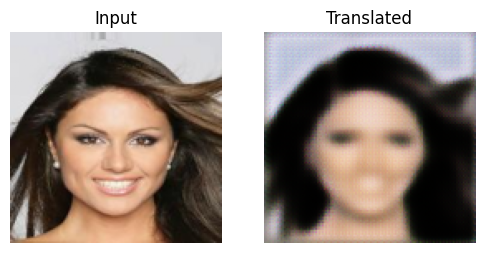

Epoch 2/10
GenG: 4.6566, GenF: 4.4881, DiscX: 0.4385, DiscY: 0.3904


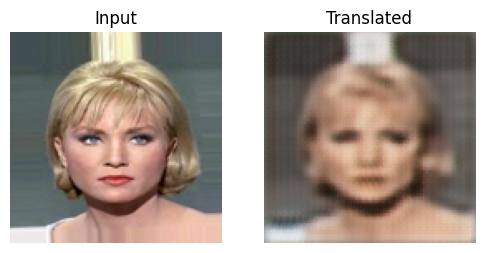

Epoch 3/10
GenG: 3.3153, GenF: 3.3267, DiscX: 0.4009, DiscY: 0.5045


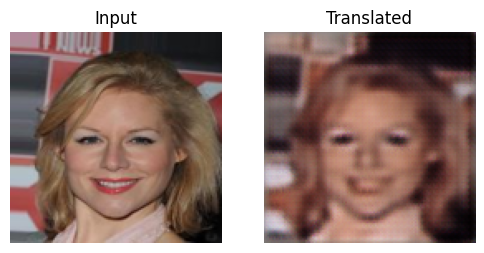

Epoch 4/10
GenG: 3.8896, GenF: 3.8919, DiscX: 0.4383, DiscY: 0.3727


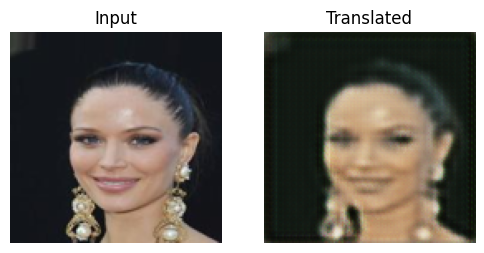

Epoch 5/10
GenG: 3.3093, GenF: 3.3319, DiscX: 0.4350, DiscY: 0.4328


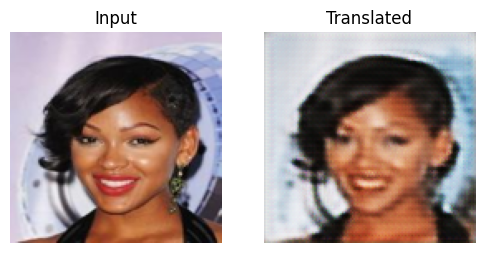

Epoch 6/10
GenG: 2.7441, GenF: 2.9370, DiscX: 0.6053, DiscY: 0.4187


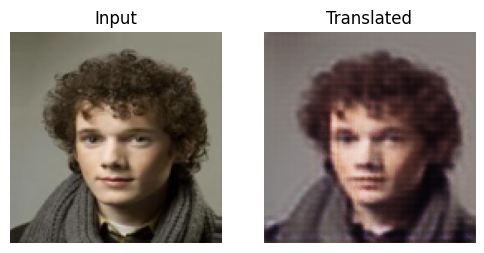

Epoch 7/10
GenG: 3.3577, GenF: 3.2781, DiscX: 0.3997, DiscY: 0.3597


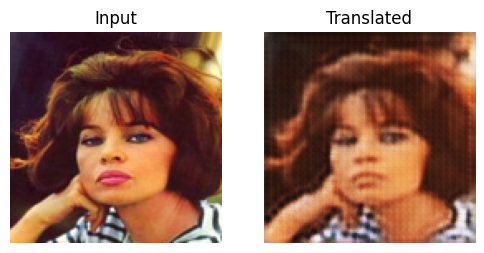

Epoch 8/10
GenG: 2.7649, GenF: 3.0999, DiscX: 0.5281, DiscY: 0.6071


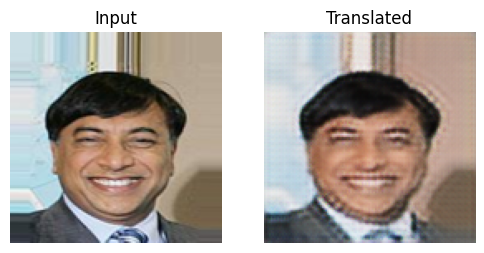

Epoch 9/10
GenG: 2.5855, GenF: 2.5605, DiscX: 0.5089, DiscY: 0.5477


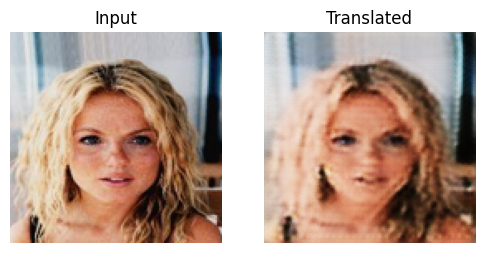

Epoch 10/10
GenG: 2.7221, GenF: 2.6425, DiscX: 0.5217, DiscY: 0.4650


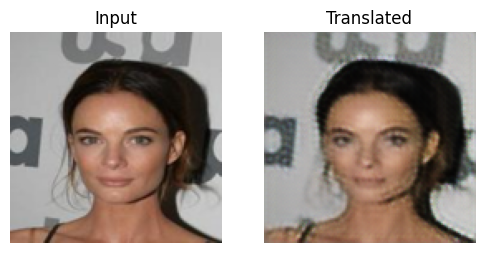

In [18]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import zipfile
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

AUTOTUNE = tf.data.AUTOTUNE
IMG_SIZE = 128
BATCH_SIZE = 4
EPOCHS = 10

# =============================
# 1. Load CelebA and Split into Domain A (real) and Domain B (painted)
# =============================
def load_celeba_split(zip_path, image_size=(IMG_SIZE, IMG_SIZE), limit=1000):
    with zipfile.ZipFile(zip_path, 'r') as zf:
        image_files = sorted([f for f in zf.namelist() if f.endswith('.jpg')])[:limit]
        random.shuffle(image_files)
        half = len(image_files) // 2
        domain_a = image_files[:half]
        domain_b = image_files[half:]

        def extract_images(file_list):
            images = []
            for file in file_list:
                with zf.open(file) as f:
                    img = Image.open(f).convert('RGB').resize(image_size)
                    img = np.array(img).astype(np.float32)
                    images.append(img)
            images_np = np.stack(images)
            return (images_np / 127.5) - 1  # Normalize to [-1, 1]

        return extract_images(domain_a), extract_images(domain_b)

images_a, images_b = load_celeba_split("Datasets/img_align_celeba.zip")
train_a = tf.data.Dataset.from_tensor_slices(images_a).shuffle(1000).batch(BATCH_SIZE).prefetch(AUTOTUNE)
train_b = tf.data.Dataset.from_tensor_slices(images_b).shuffle(1000).batch(BATCH_SIZE).prefetch(AUTOTUNE)

# =============================
# 2. Generator Model (ResNet)
# =============================
def build_generator():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = layers.Conv2D(64, 7, padding='same')(inputs)
    x = layers.ReLU()(x)
    x = layers.Conv2D(128, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(256, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)

    # 3 Residual blocks
    for _ in range(3):
        res = x
        x = layers.Conv2D(256, 3, padding='same')(x)
        x = layers.ReLU()(x)
        x = layers.Conv2D(256, 3, padding='same')(x)
        x = layers.Add()([x, res])

    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)
    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = layers.ReLU()(x)
    outputs = layers.Conv2D(3, 7, activation='tanh', padding='same')(x)
    return tf.keras.Model(inputs, outputs)

# =============================
# 3. Discriminator Model
# =============================
def build_discriminator():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = layers.Conv2D(64, 4, strides=2, padding='same')(inputs)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(256, 4, strides=2, padding='same')(x)
    x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(1, 4, padding='same')(x)
    return tf.keras.Model(inputs, x)

# =============================
# 4. Loss Functions and Optimizers
# =============================
adv_loss = tf.keras.losses.MeanSquaredError()
cycle_loss_fn = tf.keras.losses.MeanAbsoluteError()

generator_g = build_generator()  # A → B
generator_f = build_generator()  # B → A
discriminator_x = build_discriminator()  # A
discriminator_y = build_discriminator()  # B

gen_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
gen_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
disc_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
disc_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# =============================
# 5. Training Step
# =============================
@tf.function
def train_step(real_x, real_y):
    with tf.GradientTape(persistent=True) as tape:
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        gen_g_loss = adv_loss(tf.ones_like(disc_fake_y), disc_fake_y)
        gen_f_loss = adv_loss(tf.ones_like(disc_fake_x), disc_fake_x)

        cycle_loss = cycle_loss_fn(real_x, cycled_x) + cycle_loss_fn(real_y, cycled_y)
        identity_loss = cycle_loss_fn(real_x, same_x) + cycle_loss_fn(real_y, same_y)

        total_gen_g = gen_g_loss + 10 * cycle_loss + 5 * identity_loss
        total_gen_f = gen_f_loss + 10 * cycle_loss + 5 * identity_loss

        disc_x_loss = adv_loss(tf.ones_like(disc_real_x), disc_real_x) + adv_loss(tf.zeros_like(disc_fake_x), disc_fake_x)
        disc_y_loss = adv_loss(tf.ones_like(disc_real_y), disc_real_y) + adv_loss(tf.zeros_like(disc_fake_y), disc_fake_y)

    gen_g_grads = tape.gradient(total_gen_g, generator_g.trainable_variables)
    gen_f_grads = tape.gradient(total_gen_f, generator_f.trainable_variables)
    disc_x_grads = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    disc_y_grads = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    gen_g_optimizer.apply_gradients(zip(gen_g_grads, generator_g.trainable_variables))
    gen_f_optimizer.apply_gradients(zip(gen_f_grads, generator_f.trainable_variables))
    disc_x_optimizer.apply_gradients(zip(disc_x_grads, discriminator_x.trainable_variables))
    disc_y_optimizer.apply_gradients(zip(disc_y_grads, discriminator_y.trainable_variables))

    return total_gen_g, total_gen_f, disc_x_loss, disc_y_loss

# =============================
# 6. Training Loop + Visualization
# =============================
def generate_images(model, input_img):
    prediction = model(input_img, training=False)[0]
    plt.figure(figsize=(6,3))
    plt.subplot(1,2,1)
    plt.imshow((input_img[0]+1)/2)
    plt.title('Input')
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.imshow((prediction+1)/2)
    plt.title('Translated')
    plt.axis('off')
    plt.show()

def train(train_a, train_b, epochs):
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        for real_x, real_y in tf.data.Dataset.zip((train_a, train_b)):
            g1, g2, d1, d2 = train_step(real_x, real_y)
        print(f"GenG: {g1:.4f}, GenF: {g2:.4f}, DiscX: {d1:.4f}, DiscY: {d2:.4f}")
        generate_images(generator_g, real_x)

train(train_a, train_b, epochs=EPOCHS)
